# Decision Tree

In [1]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
from sklearn.preprocessing import PowerTransformer, RobustScaler
from sklearn.model_selection import train_test_split, cross_val_score, GridSearchCV
from sklearn.tree import DecisionTreeRegressor
from sklearn.metrics import mean_squared_error
from statsmodels.stats.outliers_influence import variance_inflation_factor

In [41]:
df = pd.read_csv('dataset.csv')
df = df[df['Position'] != 'Goalkeeper']
df = df.drop('index', axis = 1)
df = df.drop('Minutes', axis = 1)
df = df.drop('level_0', axis = 1)
df

,Player,Age,Matches Played,Start,Goals,Assists,Penalties Made,Yellow Cards,Red Cards,Shots,...,Successful Challenge %,Blocks,Interceptions,Tackles + Interceptions,Clearances,Errors,Club,Position,Nation,Value
0,Bruno Fernandes,27,37,37,8.0,8.0,2.0,6.0,0.0,90,...,42.3,37.0,25,93.0,40.0,1.0,Manchester United,midfield,Portugal,74900000.0
1,Randal Kolo Muani,23,32,31,15.0,11.0,2.0,6.0,1.0,75,...,11.1,19.0,3,17.0,13.0,0.0,Eintracht Frankfurt,Attack,France,64000000.0
2,Victor Osimhen,23,32,30,26.0,4.0,2.0,4.0,0.0,132,...,0.0,6.0,6,16.0,29.0,0.0,SSC Napoli,Attack,Nigeria,55000000.0
3,Bukayo Saka,20,38,37,14.0,11.0,2.0,6.0,0.0,86,...,45.5,38.0,14,77.0,19.0,0.0,Arsenal FC,Attack,England,55000000.0
4,Vinicius Junior,22,33,32,10.0,9.0,0.0,10.0,1.0,77,...,35.9,24.0,6,36.0,1.0,0.0,Real Madrid,Attack,Brazil,50000000.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1744,Carlos Soler,25,26,14,3.0,2.0,0.0,0.0,0.0,10,...,52.6,12.0,4,24.0,6.0,0.0,Paris Saint-Germain,midfield,Spain,-25000000.0
1745,Ansu Fati,19,36,12,7.0,3.0,0.0,3.0,0.0,61,...,27.8,19.0,5,21.0,6.0,0.0,FC Barcelona,Attack,Spain,-25000000.0
1746,Romelu Lukaku,29,25,19,10.0,6.0,2.0,1.0,0.0,49,...,40.0,3.0,0,3.0,16.0,0.0,Chelsea FC,Attack,Belgium,-30000000.0
1747,Jadon Sancho,22,26,21,6.0,3.0,0.0,0.0,0.0,21,...,28.6,25.0,7,23.0,6.0,0.0,Manchester United,Attack,England,-30000000.0


# Attacker

In [42]:
attacker = df[df['Position'] == 'Attack']
attacker.head()

,Player,Age,Matches Played,Start,Goals,Assists,Penalties Made,Yellow Cards,Red Cards,Shots,...,Successful Challenge %,Blocks,Interceptions,Tackles + Interceptions,Clearances,Errors,Club,Position,Nation,Value
1,Randal Kolo Muani,23,32,31,15.0,11.0,2.0,6.0,1.0,75,...,11.1,19.0,3,17.0,13.0,0.0,Eintracht Frankfurt,Attack,France,64000000.0
2,Victor Osimhen,23,32,30,26.0,4.0,2.0,4.0,0.0,132,...,0.0,6.0,6,16.0,29.0,0.0,SSC Napoli,Attack,Nigeria,55000000.0
3,Bukayo Saka,20,38,37,14.0,11.0,2.0,6.0,0.0,86,...,45.5,38.0,14,77.0,19.0,0.0,Arsenal FC,Attack,England,55000000.0
4,Vinicius Junior,22,33,32,10.0,9.0,0.0,10.0,1.0,77,...,35.9,24.0,6,36.0,1.0,0.0,Real Madrid,Attack,Brazil,50000000.0
8,Rodrygo,21,34,25,9.0,8.0,1.0,4.0,0.0,97,...,17.4,23.0,8,25.0,5.0,0.0,Real Madrid,Attack,Brazil,40000000.0


In [43]:
attacker.columns

Index(['Player', 'Age', 'Matches Played', 'Start', 'Goals', 'Assists',
       'Penalties Made', 'Yellow Cards', 'Red Cards', 'Shots',
       'Shots On Target', 'Shots On Target %', 'Goals Per Shot',
       'Goals Per Shot On Target', 'Average Shot Distance',
       'Shots From Freekicks', 'Passes Completed', 'Passes',
       'Pass Completion %', 'Total Passing Distance',
       'Progressive Passing Distance', 'Shot-Creating Actions',
       'Shot-Creating Actions/90', 'SCA Pass Live', 'SCA Pass Dead',
       'SCA Take-ons', 'SCA Shots', 'SCA Fouls', 'SCA Defense',
       'Goal-Creating Actions', 'Goal-Creating Actions/90', 'Goal Pass Live',
       'Goal Pass Dead', 'Goal Take-ons', 'Goal Shots', 'Goal Fouls',
       'Goal Defense', 'Tackles', 'Tackles Won', 'Challenges',
       'Successful Challenge %', 'Blocks', 'Interceptions',
       'Tackles + Interceptions', 'Clearances', 'Errors', 'Club', 'Position',
       'Nation', 'Value'],
      dtype='object')

In [46]:
X = attacker.drop(['Player','Yellow Cards', 'Red Cards', 'Value', 'Nation', 'Club', 'Position', 'Passes Completed', 'Passes',
       'Pass Completion %', 'Total Passing Distance',
       'Progressive Passing Distance', 'Shot-Creating Actions',
       'Shot-Creating Actions/90', 'SCA Pass Live', 'SCA Pass Dead',
       'SCA Take-ons', 'SCA Shots', 'SCA Fouls', 'SCA Defense', 'Goal-Creating Actions/90', 'Goal Pass Live',
       'Goal Pass Dead', 'Goal Take-ons', 'Goal Shots', 'Goal Fouls',
       'Goal Defense', 'Tackles', 'Tackles Won', 'Challenges',
       'Successful Challenge %', 'Blocks', 'Interceptions',
       'Tackles + Interceptions', 'Clearances', 'Errors'],axis=1)
y = attacker['Value']

In [47]:
X.dtypes

Age                           int64
Matches Played                int64
Start                         int64
Goals                       float64
Assists                     float64
Penalties Made              float64
Shots                         int64
Shots On Target               int64
Shots On Target %           float64
Goals Per Shot              float64
Goals Per Shot On Target    float64
Average Shot Distance       float64
Shots From Freekicks        float64
Goal-Creating Actions       float64
dtype: object

# Model Training

In [7]:
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.25, random_state=0)

In [8]:
#Robust Scaler
rs= RobustScaler()
X_train = rs.fit_transform(X_train)
X_test = rs.transform(X_test)

In [9]:
DtReg = DecisionTreeRegressor(random_state=0)
DtReg.fit(X_train,y_train)

DecisionTreeRegressor(random_state=0)

In [10]:
cross_val_train = cross_val_score(DtReg, X_train, y_train, scoring="neg_root_mean_squared_error",cv=5)
cross_val_test = cross_val_score(DtReg, X_test, y_test, scoring="neg_root_mean_squared_error",cv=5)
#Train Results
cross_val_train_mean = round(-(cross_val_train.mean()),2)
cross_val_train_max = round(-(cross_val_train.min()),2)
cross_val_train_min = round(-(cross_val_train.max()),2)

#Test Results
cross_val_test_mean = round(-(cross_val_test.mean()),2)
cross_val_test_max = round(-(cross_val_test.min()),2)
cross_val_test_min = round(-(cross_val_test.max()),2)

#Creating a Dataframe to display Validation Results
results = pd.DataFrame(columns=['Train/Test','Avg RMSE','Max RMSE','Min RMSE'])
results.loc[0] = ['Train',cross_val_train_mean,cross_val_train_max,cross_val_train_min]
results.loc[1] = ['Test', cross_val_test_mean, cross_val_test_max, cross_val_test_min]

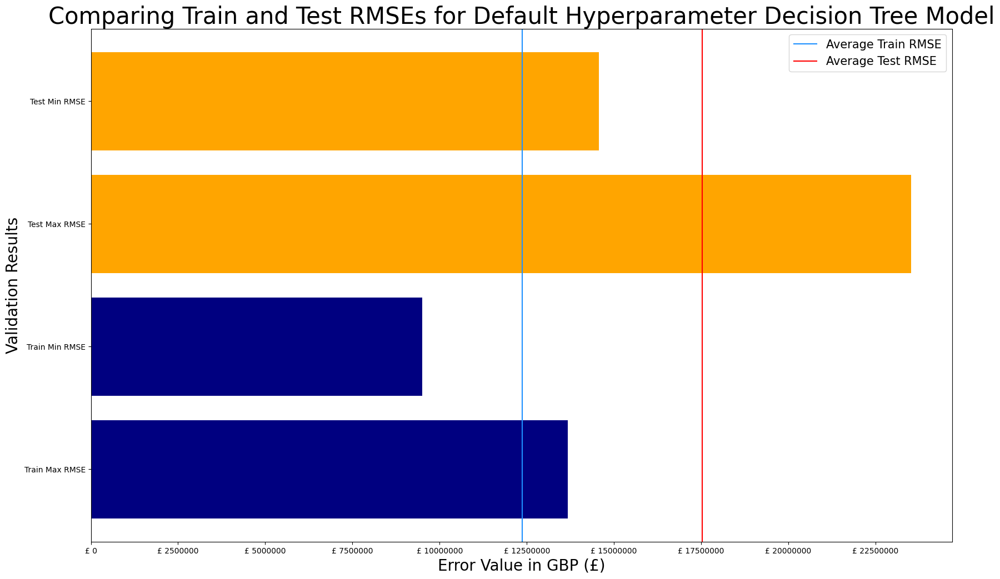

In [11]:
fig, ax = plt.subplots(figsize=(20,12))

x_ticks = list(range(0,max([results.iloc[0][2],(round(results.iloc[1][2])+1000000)]),2500000))
y_ticks = [1,2,3,4]
y_labels = ['Train Max RMSE','Train Min RMSE','Test Max RMSE','Test Min RMSE']

train_max_pos = 1
train_max = results.iloc[0][2]
ax.barh(train_max_pos,train_max,color='navy')

train_min_pos = 2
train_min = results.iloc[0][3]
ax.barh(train_min_pos,train_min,color='navy')

test_max_pos = 3
test_max = results.iloc[1][2]
ax.barh(test_max_pos,test_max,color='orange')

test_min_pos = 4
test_min = results.iloc[1][3]
ax.barh(test_min_pos,test_min,color='orange')

results_att = pd.DataFrame(columns=['Train/Test','Avg RMSE','Max RMSE','Min RMSE'])
results_att.loc[0] = ['Train',cross_val_train_mean,cross_val_train_max,cross_val_train_min]
results_att.loc[1] = ['Test', cross_val_test_mean, cross_val_test_max, cross_val_test_min]

ax.axvline(x = results.iloc[0][1],label = 'Average Train RMSE',color='dodgerblue')
ax.axvline(x = results.iloc[1][1],label = 'Average Test RMSE',color='red')

ax.set_yticks(y_ticks)
ax.set_yticklabels(y_labels)
ax.set_xticks(x_ticks)
ax.set_xticklabels([f'£ {a}' for a in x_ticks])
ax.set_xlabel('Error Value in GBP (£)',fontsize=20)
ax.set_ylabel('Validation Results',fontsize=20)
ax.set_title('Comparing Train and Test RMSEs for Default Hyperparameter Decision Tree Model',fontsize=30)
ax.legend(fontsize=15)

In [12]:
results_att

,Train/Test,Avg RMSE,Max RMSE,Min RMSE
0,Train,12364121.04,13671277.75,9498219.53
1,Test,17525034.97,23515224.76,14564390.73


In [13]:
from sklearn.metrics import r2_score

# Predict on the training and testing sets
y_train_pred = DtReg.predict(X_train)
y_test_pred = DtReg.predict(X_test)

# Calculate R-squared
train_r2 = r2_score(y_train, y_train_pred)
test_r2 = r2_score(y_test, y_test_pred)

# Calculate the number of features
num_features = X_train.shape[1]

# Calculate adjusted R-squared
train_adj_r2 = 1 - (1 - train_r2) * ((len(y_train) - 1) / (len(y_train) - num_features - 1))
test_adj_r2 = 1 - (1 - test_r2) * ((len(y_test) - 1) / (len(y_test) - num_features - 1))

# Print the R-squared and adjusted R-squared values
print("Train R-squared:", train_r2)
print("Test R-squared:", test_r2)
print("Train Adjusted R-squared:", train_adj_r2)
print("Test Adjusted R-squared:", test_adj_r2)

Train R-squared: 1.0
Test R-squared: 0.029993795246374355
Train Adjusted R-squared: 1.0
Test Adjusted R-squared: -0.11146544294686267


In [14]:
vif = pd.DataFrame()
vif["Variable"] = X.columns
vif["VIF"] = [variance_inflation_factor(X.values, i) for i in range(X.shape[1])]
print(vif)

                    Variable        VIF
0                        Age  24.407682
1             Matches Played  27.691883
2                      Start  18.181087
3                      Goals  30.984957
4                    Assists   7.910763
5             Penalties Made   3.340899
6                      Shots  68.323081
7            Shots On Target  74.518030
8          Shots On Target %  15.084791
9             Goals Per Shot  27.897223
10  Goals Per Shot On Target  22.769806
11     Average Shot Distance  19.350885
12      Shots From Freekicks   1.700075
13     Goal-Creating Actions  13.477045


<Axes: >

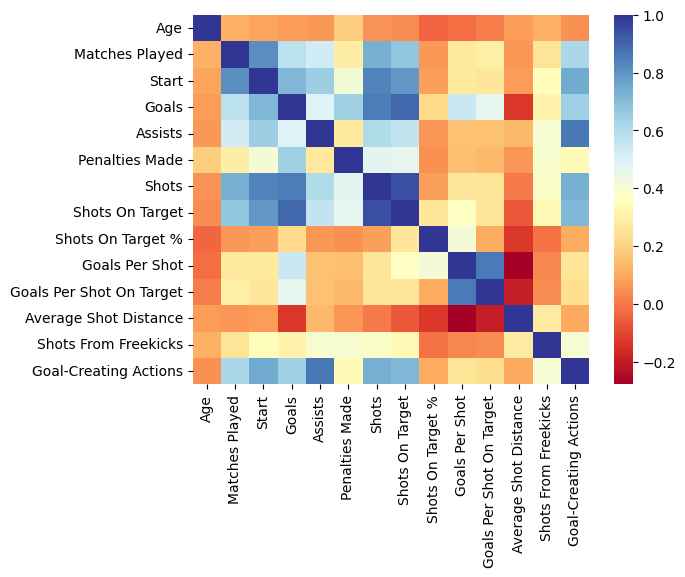

In [15]:
correlation_matrix = X.corr()
sns.heatmap(correlation_matrix, annot = False, cmap='RdYlBu')

In [16]:
X = X.drop(['Matches Played', 'Start', 'Shots', 'Shots On Target', 'Penalties Made', 'Goals Per Shot On Target'], axis=1)

In [17]:
vif = pd.DataFrame()
vif["Variable"] = X.columns
vif["VIF"] = [variance_inflation_factor(X.values, i) for i in range(X.shape[1])]
print(vif)

                Variable        VIF
0                    Age  20.647125
1                  Goals   4.830635
2                Assists   7.827169
3      Shots On Target %   9.368276
4         Goals Per Shot   5.332748
5  Average Shot Distance  17.605422
6   Shots From Freekicks   1.528689
7  Goal-Creating Actions  11.943938


In [18]:
X_train, X_test, y_train, y_test = train_test_split(X,y,test_size=0.25,random_state=0)

In [19]:
rs= RobustScaler()
X_train = rs.fit_transform(X_train)
X_test = rs.transform(X_test)

In [20]:
pt = PowerTransformer()
X_train = pt.fit_transform(X_train)
X_test = pt.transform(X_test)

In [29]:
DtReg = DecisionTreeRegressor()
DtReg.fit(X_train,y_train)

DecisionTreeRegressor()

In [30]:
cross_val_train = cross_val_score(DtReg, X_train, y_train, scoring="neg_root_mean_squared_error",cv=5)
cross_val_test = cross_val_score(DtReg, X_test, y_test, scoring="neg_root_mean_squared_error",cv=5)
#Train Results
cross_val_train_mean = round(-(cross_val_train.mean()),2)
cross_val_train_max = round(-(cross_val_train.min()),2)
cross_val_train_min = round(-(cross_val_train.max()),2)

#Test Results
cross_val_test_mean = round(-(cross_val_test.mean()),2)
cross_val_test_max = round(-(cross_val_test.min()),2)
cross_val_test_min = round(-(cross_val_test.max()),2)

#Creating a Dataframe to display Validation Results
results = pd.DataFrame(columns=['Train/Test','Avg RMSE','Max RMSE','Min RMSE'])
results.loc[0] = ['Train',cross_val_train_mean,cross_val_train_max,cross_val_train_min]
results.loc[1] = ['Test', cross_val_test_mean, cross_val_test_max, cross_val_test_min]

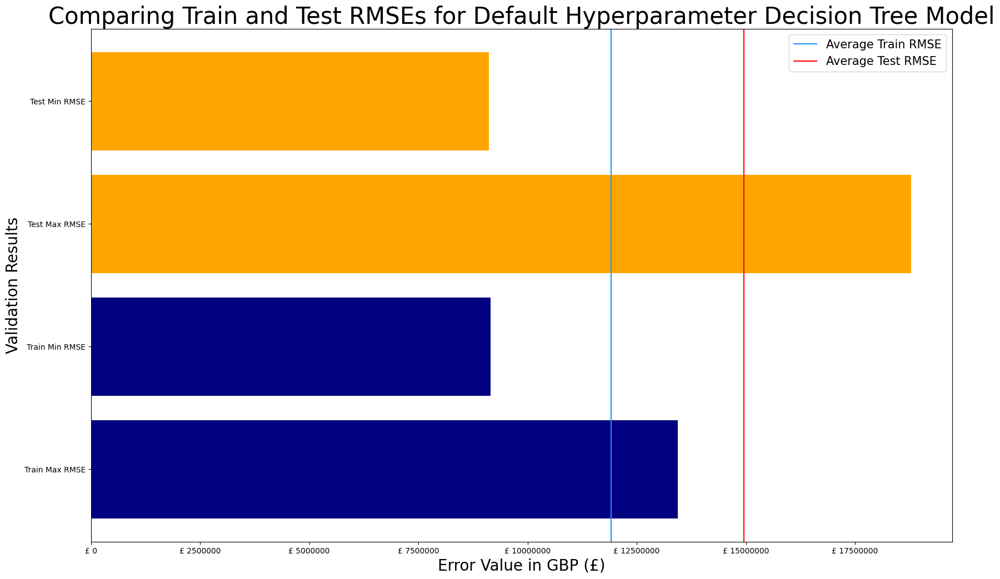

In [31]:
fig, ax = plt.subplots(figsize=(20,12))

x_ticks = list(range(0,max([results.iloc[0][2],(round(results.iloc[1][2])+1000000)]),2500000))
y_ticks = [1,2,3,4]
y_labels = ['Train Max RMSE','Train Min RMSE','Test Max RMSE','Test Min RMSE']

train_max_pos = 1
train_max = results.iloc[0][2]
ax.barh(train_max_pos,train_max,color='navy')

train_min_pos = 2
train_min = results.iloc[0][3]
ax.barh(train_min_pos,train_min,color='navy')

test_max_pos = 3
test_max = results.iloc[1][2]
ax.barh(test_max_pos,test_max,color='orange')

test_min_pos = 4
test_min = results.iloc[1][3]
ax.barh(test_min_pos,test_min,color='orange')

results_att = pd.DataFrame(columns=['Train/Test','Avg RMSE','Max RMSE','Min RMSE'])
results_att.loc[0] = ['Train',cross_val_train_mean,cross_val_train_max,cross_val_train_min]
results_att.loc[1] = ['Test', cross_val_test_mean, cross_val_test_max, cross_val_test_min]

ax.axvline(x = results.iloc[0][1],label = 'Average Train RMSE',color='dodgerblue')
ax.axvline(x = results.iloc[1][1],label = 'Average Test RMSE',color='red')

ax.set_yticks(y_ticks)
ax.set_yticklabels(y_labels)
ax.set_xticks(x_ticks)
ax.set_xticklabels([f'£ {a}' for a in x_ticks])
ax.set_xlabel('Error Value in GBP (£)',fontsize=20)
ax.set_ylabel('Validation Results',fontsize=20)
ax.set_title('Comparing Train and Test RMSEs for Default Hyperparameter Decision Tree Model',fontsize=30)
ax.legend(fontsize=15)

In [32]:
results_att

,Train/Test,Avg RMSE,Max RMSE,Min RMSE
0,Train,11920243.52,13439305.59,9147884.34
1,Test,14952210.37,18780760.28,9120755.55


In [33]:
from sklearn.metrics import r2_score

# Predict on the training and testing sets
y_train_pred = DtReg.predict(X_train)
y_test_pred = DtReg.predict(X_test)

# Calculate R-squared
train_r2 = r2_score(y_train, y_train_pred)
test_r2 = r2_score(y_test, y_test_pred)

# Calculate the number of features
num_features = X_train.shape[1]

# Calculate adjusted R-squared
train_adj_r2 = 1 - (1 - train_r2) * ((len(y_train) - 1) / (len(y_train) - num_features - 1))
test_adj_r2 = 1 - (1 - test_r2) * ((len(y_test) - 1) / (len(y_test) - num_features - 1))

# Print the R-squared and adjusted R-squared values
print("Train R-squared:", train_r2)
print("Test R-squared:", test_r2)
print("Train Adjusted R-squared:", train_adj_r2)
print("Test Adjusted R-squared:", test_adj_r2)

Train R-squared: 1.0
Test R-squared: -0.06681161519528978
Train Adjusted R-squared: 1.0
Test Adjusted R-squared: -0.1504831144262928


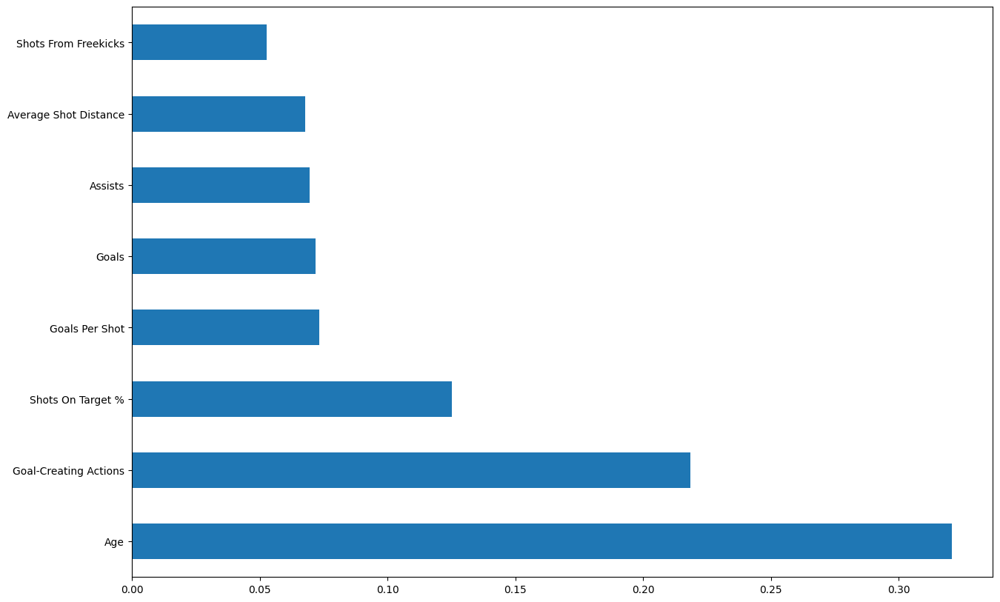

In [34]:
fig,ax = plt.subplots(figsize=(15,10))

feat_importances = pd.Series(DtReg.feature_importances_, index=X.columns)

feat_importances.nlargest(10).plot(kind='barh')

plt.show()

# Tuning

In [35]:
parameters={"splitter":["best","random"],
            "max_depth" : [1,3,5,7,9,11,12],
           "min_samples_leaf":[1,2,3,4,5,6,7,8,9,10],
           "min_weight_fraction_leaf":[0.1,0.2,0.3,0.4,0.5,0.6,0.7,0.8,0.9],
           "max_features":["auto","log2","sqrt",None],
           "max_leaf_nodes":[None,10,20,30,40,50,60,70,80,90] }

In [36]:
tuning_model=GridSearchCV(DtReg,param_grid=parameters,scoring='neg_root_mean_squared_error',cv=5,verbose=5)

In [205]:
from contextlib import contextmanager
import sys
import os

@contextmanager
def suppress_stdout():
    with open(os.devnull, "w") as devnull:
        old_stdout = sys.stdout
        sys.stdout = devnull
        try:
            yield
        finally:
            sys.stdout = old_stdout

# Usage
with suppress_stdout():
    tuning_model.fit(X_train, y_train)


/Users/tony/Library/Python/3.9/lib/python/site-packages/sklearn/tree/_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
/Users/tony/Library/Python/3.9/lib/python/site-packages/sklearn/tree/_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
/Users/tony/Library/Python/3.9/lib/python/site-packages/sklearn/tree/_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
/Users/tony/Library/Python/3.9/lib/python/site-packages/sklearn/tree/_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `m

In [206]:
tuning_model.best_params_

{'max_depth': 5,
 'max_features': None,
 'max_leaf_nodes': 90,
 'min_samples_leaf': 3,
 'min_weight_fraction_leaf': 0.1,
 'splitter': 'random'}

In [207]:
param_values = list((tuning_model.best_params_).values())
param_values

[5, None, 90, 3, 0.1, 'random']

In [208]:
DtReg_Grid = DecisionTreeRegressor(max_depth=param_values[0],
                                 max_features=param_values[1],
                                 max_leaf_nodes=param_values[2],
                                 min_samples_leaf=param_values[3],
                                 min_weight_fraction_leaf=param_values[4],
                                 splitter=param_values[5])

DtReg_Grid.fit(X_train,y_train)

DecisionTreeRegressor(max_depth=5, max_leaf_nodes=90, min_samples_leaf=3,
                      min_weight_fraction_leaf=0.1, splitter='random')

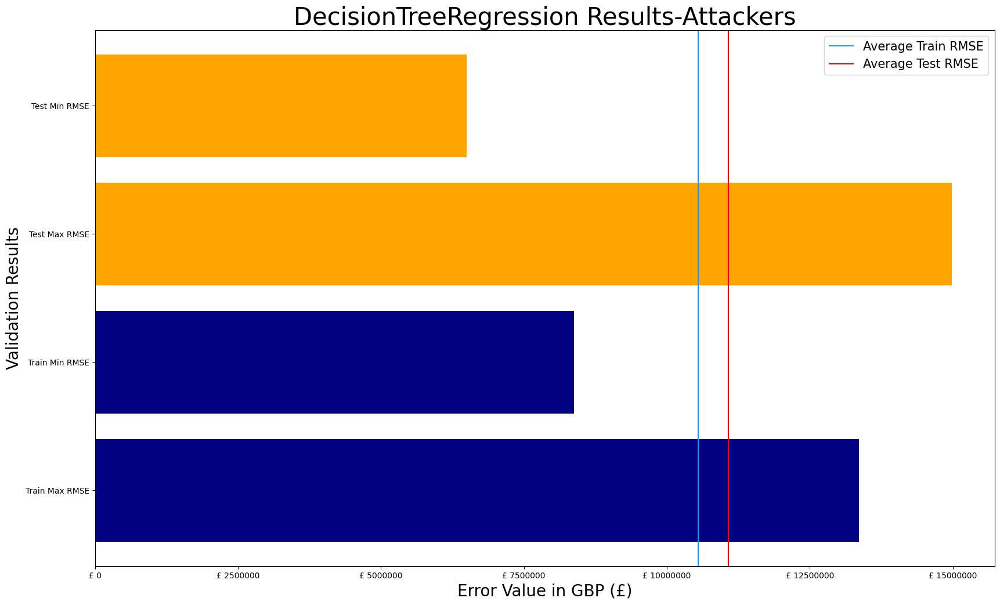

In [209]:
cross_val_train = cross_val_score(DtReg_Grid, X_train, y_train, scoring="neg_root_mean_squared_error",cv=5)
cross_val_test = cross_val_score(DtReg_Grid, X_test, y_test, scoring="neg_root_mean_squared_error",cv=5)
#Train Results
cross_val_train_mean = round(-(cross_val_train.mean()),2)
cross_val_train_max = round(-(cross_val_train.min()),2)
cross_val_train_min = round(-(cross_val_train.max()),2)

#Test Results
cross_val_test_mean = round(-(cross_val_test.mean()),2)
cross_val_test_max = round(-(cross_val_test.min()),2)
cross_val_test_min = round(-(cross_val_test.max()),2)

#Creating a Dataframe to display Validation Results
results_att = pd.DataFrame(columns=['Train/Test','Avg RMSE','Max RMSE','Min RMSE'])
results_att.loc[0] = ['Train',cross_val_train_mean,cross_val_train_max,cross_val_train_min]
results_att.loc[1] = ['Test', cross_val_test_mean, cross_val_test_max, cross_val_test_min]
fig, ax = plt.subplots(figsize=(20,12))

x_ticks = list(range(0,max([results_att.iloc[0][2],(round(results_att.iloc[1][2])+1000000)]),2500000))
y_ticks = [1,2,3,4]
y_labels = ['Train Max RMSE','Train Min RMSE','Test Max RMSE','Test Min RMSE']

train_max_pos = 1
train_max = results_att.iloc[0][2]
ax.barh(train_max_pos,train_max,color='navy')

train_min_pos = 2
train_min = results_att.iloc[0][3]
ax.barh(train_min_pos,train_min,color='navy')

test_max_pos = 3
test_max = results_att.iloc[1][2]
ax.barh(test_max_pos,test_max,color='orange')

test_min_pos = 4
test_min = results_att.iloc[1][3]
ax.barh(test_min_pos,test_min,color='orange')

ax.axvline(x = results_att.iloc[0][1],label = 'Average Train RMSE',color='dodgerblue')
ax.axvline(x = results_att.iloc[1][1],label = 'Average Test RMSE',color='red')

ax.set_yticks(y_ticks)
ax.set_yticklabels(y_labels)
ax.set_xticks(x_ticks)
ax.set_xticklabels([f'£ {a}' for a in x_ticks])
ax.set_xlabel('Error Value in GBP (£)',fontsize=20)
ax.set_ylabel('Validation Results',fontsize=20)
ax.set_title('DecisionTreeRegression Results-Attackers',fontsize=30)
ax.legend(fontsize=15)

In [210]:
results_att

,Train/Test,Avg RMSE,Max RMSE,Min RMSE
0,Train,10545922.14,13360912.94,8379812.18
1,Test,11070549.96,14978680.73,6495008.62


In [211]:
from sklearn.metrics import r2_score

# Predict on the training and testing sets
y_train_pred = DtReg_Grid.predict(X_train)
y_test_pred = DtReg_Grid.predict(X_test)

# Calculate R-squared
train_r2 = r2_score(y_train, y_train_pred)
test_r2 = r2_score(y_test, y_test_pred)

# Calculate the number of features
num_features = X_train.shape[1]

# Calculate adjusted R-squared
train_adj_r2 = 1 - (1 - train_r2) * ((len(y_train) - 1) / (len(y_train) - num_features - 1))
test_adj_r2 = 1 - (1 - test_r2) * ((len(y_test) - 1) / (len(y_test) - num_features - 1))

# Print the R-squared and adjusted R-squared values
print("Train R-squared:", train_r2)
print("Test R-squared:", test_r2)
print("Train Adjusted R-squared:", train_adj_r2)
print("Test Adjusted R-squared:", test_adj_r2)

Train R-squared: 0.05607554220487776
Test R-squared: 0.13875160009354326
Train Adjusted R-squared: 0.0298554183772356
Test Adjusted R-squared: 0.06219618676852501


# Midfielders

In [49]:
midfielder = df[df['Position'] == 'midfield']
midfielder.head()

,Player,Age,Matches Played,Start,Goals,Assists,Penalties Made,Yellow Cards,Red Cards,Shots,...,Successful Challenge %,Blocks,Interceptions,Tackles + Interceptions,Clearances,Errors,Club,Position,Nation,Value
0,Bruno Fernandes,27,37,37,8.0,8.0,2.0,6.0,0.0,90,...,42.3,37.0,25,93.0,40.0,1.0,Manchester United,midfield,Portugal,74900000.0
6,Jamal Musiala,19,33,26,12.0,10.0,0.0,1.0,0.0,66,...,37.1,30.0,19,53.0,3.0,0.0,Bayern Munich,midfield,Germany,45000000.0
7,Martin Odegaard,23,37,37,15.0,7.0,0.0,4.0,0.0,93,...,29.8,20.0,6,42.0,12.0,1.0,Arsenal FC,midfield,Norway,45000000.0
11,Jude Bellingham,19,31,30,8.0,4.0,1.0,8.0,0.0,66,...,66.7,51.0,35,111.0,30.0,0.0,Real Madrid,midfield,England,40000000.0
12,Vitinha,22,17,12,7.0,2.0,0.0,2.0,0.0,48,...,42.9,17.0,4,26.0,17.0,0.0,Paris Saint-Germain,midfield,Portugal,36000000.0


In [50]:
midfielder.columns

Index(['Player', 'Age', 'Matches Played', 'Start', 'Goals', 'Assists',
       'Penalties Made', 'Yellow Cards', 'Red Cards', 'Shots',
       'Shots On Target', 'Shots On Target %', 'Goals Per Shot',
       'Goals Per Shot On Target', 'Average Shot Distance',
       'Shots From Freekicks', 'Passes Completed', 'Passes',
       'Pass Completion %', 'Total Passing Distance',
       'Progressive Passing Distance', 'Shot-Creating Actions',
       'Shot-Creating Actions/90', 'SCA Pass Live', 'SCA Pass Dead',
       'SCA Take-ons', 'SCA Shots', 'SCA Fouls', 'SCA Defense',
       'Goal-Creating Actions', 'Goal-Creating Actions/90', 'Goal Pass Live',
       'Goal Pass Dead', 'Goal Take-ons', 'Goal Shots', 'Goal Fouls',
       'Goal Defense', 'Tackles', 'Tackles Won', 'Challenges',
       'Successful Challenge %', 'Blocks', 'Interceptions',
       'Tackles + Interceptions', 'Clearances', 'Errors', 'Club', 'Position',
       'Nation', 'Value'],
      dtype='object')

In [52]:
X = midfielder.drop(['Player','Yellow Cards', 'Red Cards', 'Value', 'Nation', 'Club', 'Position','Shots',
       'Shots On Target', 'Shots On Target %', 'Goals Per Shot',
       'Goals Per Shot On Target', 'Average Shot Distance', 
        'Tackles', 'Tackles Won', 'Challenges',
       'Successful Challenge %', 'Blocks', 'Interceptions',
       'Tackles + Interceptions', 'Clearances', 'Errors'],axis=1)
y = midfielder['Value']

In [215]:
X.dtypes

Age                               int64
Matches Played                    int64
Start                             int64
Goals                           float64
Assists                         float64
Penalties Made                  float64
Shots From Freekicks            float64
Passes Completed                float64
Passes                          float64
Pass Completion %               float64
Total Passing Distance          float64
Progressive Passing Distance    float64
Shot-Creating Actions           float64
Shot-Creating Actions/90        float64
SCA Pass Live                   float64
SCA Pass Dead                   float64
SCA Take-ons                    float64
SCA Shots                       float64
SCA Fouls                       float64
SCA Defense                     float64
Goal-Creating Actions           float64
Goal-Creating Actions/90        float64
Goal Pass Live                  float64
Goal Pass Dead                  float64
Goal Take-ons                   float64


# Modeling Training

In [216]:
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.25, random_state=0)

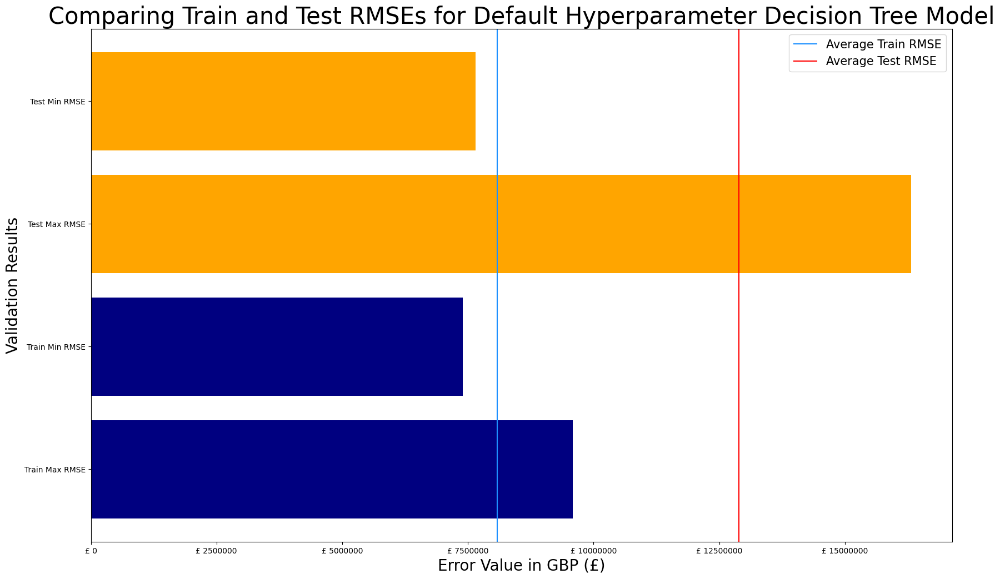

In [217]:
#Robust Scaler
rs= RobustScaler()
X_train = rs.fit_transform(X_train)
X_test = rs.transform(X_test)

DtReg = DecisionTreeRegressor()
DtReg.fit(X_train,y_train)

cross_val_train = cross_val_score(DtReg, X_train, y_train, scoring="neg_root_mean_squared_error",cv=5)
cross_val_test = cross_val_score(DtReg, X_test, y_test, scoring="neg_root_mean_squared_error",cv=5)
#Train Results
cross_val_train_mean = round(-(cross_val_train.mean()),2)
cross_val_train_max = round(-(cross_val_train.min()),2)
cross_val_train_min = round(-(cross_val_train.max()),2)

#Test Results
cross_val_test_mean = round(-(cross_val_test.mean()),2)
cross_val_test_max = round(-(cross_val_test.min()),2)
cross_val_test_min = round(-(cross_val_test.max()),2)

#Creating a Dataframe to display Validation Results
results = pd.DataFrame(columns=['Train/Test','Avg RMSE','Max RMSE','Min RMSE'])
results.loc[0] = ['Train',cross_val_train_mean,cross_val_train_max,cross_val_train_min]
results.loc[1] = ['Test', cross_val_test_mean, cross_val_test_max, cross_val_test_min]

fig, ax = plt.subplots(figsize=(20,12))

x_ticks = list(range(0,max([results.iloc[0][2],(round(results.iloc[1][2])+1000000)]),2500000))
y_ticks = [1,2,3,4]
y_labels = ['Train Max RMSE','Train Min RMSE','Test Max RMSE','Test Min RMSE']

train_max_pos = 1
train_max = results.iloc[0][2]
ax.barh(train_max_pos,train_max,color='navy')

train_min_pos = 2
train_min = results.iloc[0][3]
ax.barh(train_min_pos,train_min,color='navy')

test_max_pos = 3
test_max = results.iloc[1][2]
ax.barh(test_max_pos,test_max,color='orange')

test_min_pos = 4
test_min = results.iloc[1][3]
ax.barh(test_min_pos,test_min,color='orange')

results_mid = pd.DataFrame(columns=['Train/Test','Avg RMSE','Max RMSE','Min RMSE'])
results_mid.loc[0] = ['Train',cross_val_train_mean,cross_val_train_max,cross_val_train_min]
results_mid.loc[1] = ['Test', cross_val_test_mean, cross_val_test_max, cross_val_test_min]

ax.axvline(x = results.iloc[0][1],label = 'Average Train RMSE',color='dodgerblue')
ax.axvline(x = results.iloc[1][1],label = 'Average Test RMSE',color='red')

ax.set_yticks(y_ticks)
ax.set_yticklabels(y_labels)
ax.set_xticks(x_ticks)
ax.set_xticklabels([f'£ {a}' for a in x_ticks])
ax.set_xlabel('Error Value in GBP (£)',fontsize=20)
ax.set_ylabel('Validation Results',fontsize=20)
ax.set_title('Comparing Train and Test RMSEs for Default Hyperparameter Decision Tree Model',fontsize=30)
ax.legend(fontsize=15)

In [218]:
results_mid

,Train/Test,Avg RMSE,Max RMSE,Min RMSE
0,Train,8083157.43,9591554.66,7404425.42
1,Test,12894894.17,16314896.06,7650233.64


In [219]:
from sklearn.metrics import r2_score

# Predict on the training and testing sets
y_train_pred = DtReg.predict(X_train)
y_test_pred = DtReg.predict(X_test)

# Calculate R-squared
train_r2 = r2_score(y_train, y_train_pred)
test_r2 = r2_score(y_test, y_test_pred)

# Calculate the number of features
num_features = X_train.shape[1]

# Calculate adjusted R-squared
train_adj_r2 = 1 - (1 - train_r2) * ((len(y_train) - 1) / (len(y_train) - num_features - 1))
test_adj_r2 = 1 - (1 - test_r2) * ((len(y_test) - 1) / (len(y_test) - num_features - 1))

# Print the R-squared and adjusted R-squared values
print("Train R-squared:", train_r2)
print("Test R-squared:", test_r2)
print("Train Adjusted R-squared:", train_adj_r2)
print("Test Adjusted R-squared:", test_adj_r2)

Train R-squared: 1.0
Test R-squared: 0.1257253705391137
Train Adjusted R-squared: 1.0
Test Adjusted R-squared: -0.14328220775654366


In [220]:
vif = pd.DataFrame()
vif["Variable"] = X.columns
vif["VIF"] = [variance_inflation_factor(X.values, i) for i in range(X.shape[1])]
print(vif)

                        Variable         VIF
0                            Age   40.706088
1                 Matches Played   37.618804
2                          Start   44.956387
3                          Goals    4.929973
4                        Assists    8.183322
5                 Penalties Made    1.708489
6           Shots From Freekicks    3.533285
7               Passes Completed  719.981702
8                         Passes  986.880560
9              Pass Completion %   54.128758
10        Total Passing Distance  273.860701
11  Progressive Passing Distance   76.310851
12         Shot-Creating Actions         inf
13      Shot-Creating Actions/90   32.795987
14                 SCA Pass Live         inf
15                 SCA Pass Dead         inf
16                  SCA Take-ons         inf
17                     SCA Shots         inf
18                     SCA Fouls         inf
19                   SCA Defense         inf
20         Goal-Creating Actions         inf
21      Go

/Users/tony/Library/Python/3.9/lib/python/site-packages/statsmodels/stats/outliers_influence.py:198: RuntimeWarning: divide by zero encountered in double_scalars
  vif = 1. / (1. - r_squared_i)


In [221]:
X = X.drop(['Matches Played', 'Start','Passes','Penalties Made','Passes Completed', 'Shot-Creating Actions', 'Goal-Creating Actions', 'SCA Pass Live', 'SCA Pass Dead', 'SCA Take-ons',
'SCA Shots', 'SCA Fouls', 'SCA Defense','Goal Pass Dead', 'Goal Take-ons', 'Goal Shots', 'Goal Fouls', 'Goal Pass Live', 'Progressive Passing Distance',
'Goal Defense'], axis=1)

In [222]:
vif = pd.DataFrame()
vif["Variable"] = X.columns
vif["VIF"] = [variance_inflation_factor(X.values, i) for i in range(X.shape[1])]
print(vif)

                   Variable        VIF
0                       Age  32.626033
1                     Goals   2.792248
2                   Assists   3.962603
3      Shots From Freekicks   1.960066
4         Pass Completion %  39.257838
5    Total Passing Distance   4.186181
6  Shot-Creating Actions/90  12.471274
7  Goal-Creating Actions/90   5.553311


In [223]:
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.25, random_state=0)

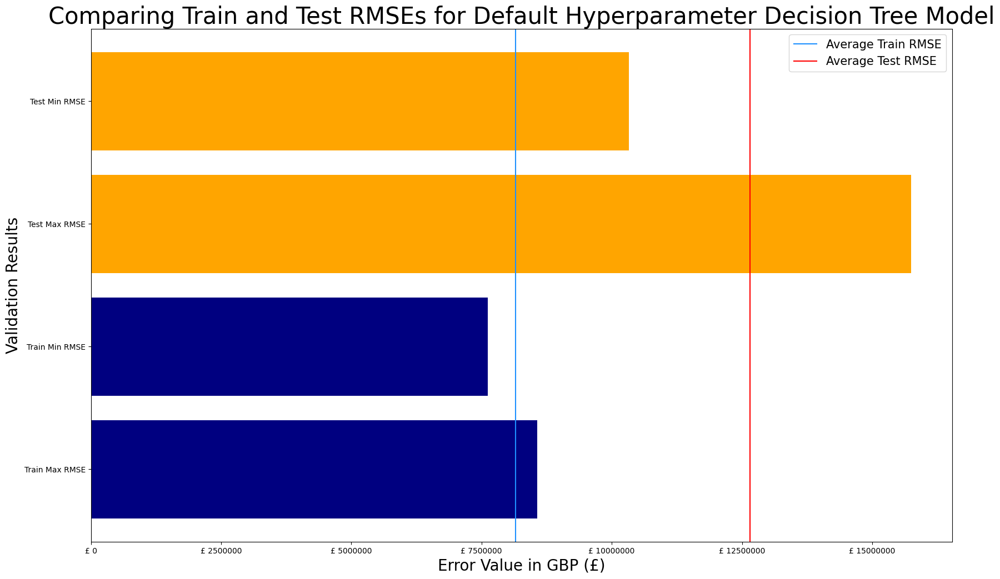

In [224]:
#Robust Scaler
rs= RobustScaler()
X_train = rs.fit_transform(X_train)
X_test = rs.transform(X_test)

pt = PowerTransformer()
X_train = pt.fit_transform(X_train)
X_test = pt.transform(X_test)

DtReg = DecisionTreeRegressor()
DtReg.fit(X_train,y_train)

cross_val_train = cross_val_score(DtReg, X_train, y_train, scoring="neg_root_mean_squared_error",cv=5)
cross_val_test = cross_val_score(DtReg, X_test, y_test, scoring="neg_root_mean_squared_error",cv=5)
#Train Results
cross_val_train_mean = round(-(cross_val_train.mean()),2)
cross_val_train_max = round(-(cross_val_train.min()),2)
cross_val_train_min = round(-(cross_val_train.max()),2)

#Test Results
cross_val_test_mean = round(-(cross_val_test.mean()),2)
cross_val_test_max = round(-(cross_val_test.min()),2)
cross_val_test_min = round(-(cross_val_test.max()),2)

#Creating a Dataframe to display Validation Results
results = pd.DataFrame(columns=['Train/Test','Avg RMSE','Max RMSE','Min RMSE'])
results.loc[0] = ['Train',cross_val_train_mean,cross_val_train_max,cross_val_train_min]
results.loc[1] = ['Test', cross_val_test_mean, cross_val_test_max, cross_val_test_min]

fig, ax = plt.subplots(figsize=(20,12))

x_ticks = list(range(0,max([results.iloc[0][2],(round(results.iloc[1][2])+1000000)]),2500000))
y_ticks = [1,2,3,4]
y_labels = ['Train Max RMSE','Train Min RMSE','Test Max RMSE','Test Min RMSE']

train_max_pos = 1
train_max = results.iloc[0][2]
ax.barh(train_max_pos,train_max,color='navy')

train_min_pos = 2
train_min = results.iloc[0][3]
ax.barh(train_min_pos,train_min,color='navy')

test_max_pos = 3
test_max = results.iloc[1][2]
ax.barh(test_max_pos,test_max,color='orange')

test_min_pos = 4
test_min = results.iloc[1][3]
ax.barh(test_min_pos,test_min,color='orange')

results_mid = pd.DataFrame(columns=['Train/Test','Avg RMSE','Max RMSE','Min RMSE'])
results_mid.loc[0] = ['Train',cross_val_train_mean,cross_val_train_max,cross_val_train_min]
results_mid.loc[1] = ['Test', cross_val_test_mean, cross_val_test_max, cross_val_test_min]

ax.axvline(x = results.iloc[0][1],label = 'Average Train RMSE',color='dodgerblue')
ax.axvline(x = results.iloc[1][1],label = 'Average Test RMSE',color='red')

ax.set_yticks(y_ticks)
ax.set_yticklabels(y_labels)
ax.set_xticks(x_ticks)
ax.set_xticklabels([f'£ {a}' for a in x_ticks])
ax.set_xlabel('Error Value in GBP (£)',fontsize=20)
ax.set_ylabel('Validation Results',fontsize=20)
ax.set_title('Comparing Train and Test RMSEs for Default Hyperparameter Decision Tree Model',fontsize=30)
ax.legend(fontsize=15)

In [225]:
results_mid

,Train/Test,Avg RMSE,Max RMSE,Min RMSE
0,Train,8154973.13,8570237.23,7615842.27
1,Test,12658643.42,15744141.55,10332956.98


In [226]:
from sklearn.metrics import r2_score

# Predict on the training and testing sets
y_train_pred = DtReg.predict(X_train)
y_test_pred = DtReg.predict(X_test)

# Calculate R-squared
train_r2 = r2_score(y_train, y_train_pred)
test_r2 = r2_score(y_test, y_test_pred)

# Calculate the number of features
num_features = X_train.shape[1]

# Calculate adjusted R-squared
train_adj_r2 = 1 - (1 - train_r2) * ((len(y_train) - 1) / (len(y_train) - num_features - 1))
test_adj_r2 = 1 - (1 - test_r2) * ((len(y_test) - 1) / (len(y_test) - num_features - 1))

# Print the R-squared and adjusted R-squared values
print("Train R-squared:", train_r2)
print("Test R-squared:", test_r2)
print("Train Adjusted R-squared:", train_adj_r2)
print("Test Adjusted R-squared:", test_adj_r2)

Train R-squared: 1.0
Test R-squared: -0.2308814617298398
Train Adjusted R-squared: 1.0
Test Adjusted R-squared: -0.31959363915181016


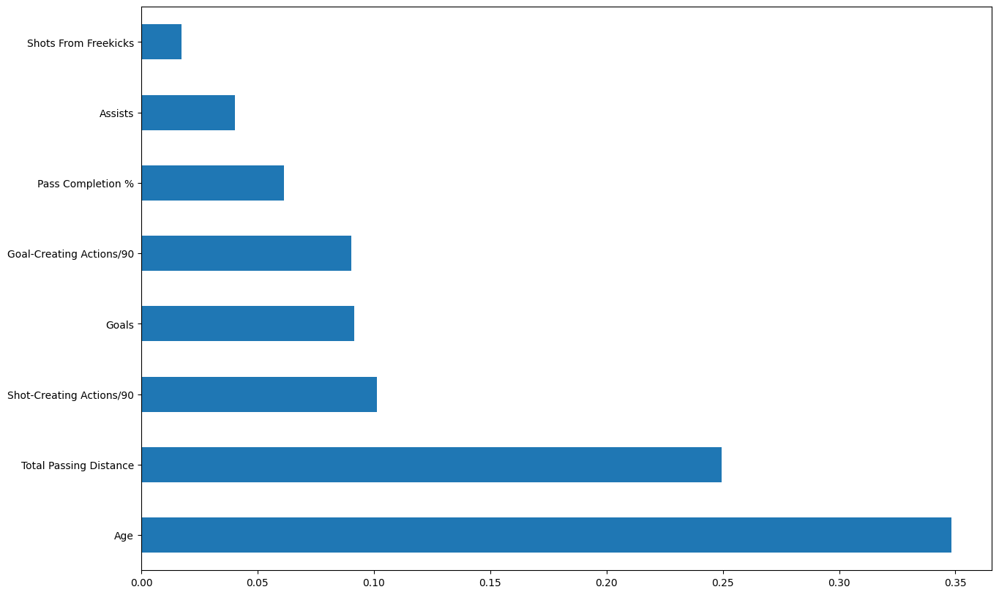

In [227]:
fig,ax = plt.subplots(figsize=(15,10))

feat_importances = pd.Series(DtReg.feature_importances_, index=X.columns)

feat_importances.nlargest(10).plot(kind='barh')

plt.show()

# Tuning

In [228]:
parameters={"splitter":["best","random"],
            "max_depth" : [1,3,5,7,9,11,12],
           "min_samples_leaf":[1,2,3,4,5,6,7,8,9,10],
           "min_weight_fraction_leaf":[0.1,0.2,0.3,0.4,0.5,0.6,0.7,0.8,0.9],
           "max_features":["auto","log2","sqrt",None],
           "max_leaf_nodes":[None,10,20,30,40,50,60,70,80,90] }

tuning_model=GridSearchCV(DtReg,param_grid=parameters,scoring='neg_root_mean_squared_error',cv=5,verbose=5)

from contextlib import contextmanager
import sys
import os

@contextmanager
def suppress_stdout():
    with open(os.devnull, "w") as devnull:
        old_stdout = sys.stdout
        sys.stdout = devnull
        try:
            yield
        finally:
            sys.stdout = old_stdout

# Usage
with suppress_stdout():
    tuning_model.fit(X_train, y_train)


/Users/tony/Library/Python/3.9/lib/python/site-packages/sklearn/tree/_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
/Users/tony/Library/Python/3.9/lib/python/site-packages/sklearn/tree/_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
/Users/tony/Library/Python/3.9/lib/python/site-packages/sklearn/tree/_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
/Users/tony/Library/Python/3.9/lib/python/site-packages/sklearn/tree/_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `m

In [229]:
tuning_model.best_params_

{'max_depth': 3,
 'max_features': 'auto',
 'max_leaf_nodes': None,
 'min_samples_leaf': 1,
 'min_weight_fraction_leaf': 0.1,
 'splitter': 'best'}

In [230]:
param_values = list((tuning_model.best_params_).values())
param_values

[3, 'auto', None, 1, 0.1, 'best']

In [231]:
DtReg_Grid = DecisionTreeRegressor(max_depth=param_values[0],
                                 max_features=param_values[1],
                                 max_leaf_nodes=param_values[2],
                                 min_samples_leaf=param_values[3],
                                 min_weight_fraction_leaf=param_values[4],
                                 splitter=param_values[5])

DtReg_Grid.fit(X_train,y_train)

/Users/tony/Library/Python/3.9/lib/python/site-packages/sklearn/tree/_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(


DecisionTreeRegressor(max_depth=3, max_features='auto',
                      min_weight_fraction_leaf=0.1)

/Users/tony/Library/Python/3.9/lib/python/site-packages/sklearn/tree/_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
/Users/tony/Library/Python/3.9/lib/python/site-packages/sklearn/tree/_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
/Users/tony/Library/Python/3.9/lib/python/site-packages/sklearn/tree/_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
/Users/tony/Library/Python/3.9/lib/python/site-packages/sklearn/tree/_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `m

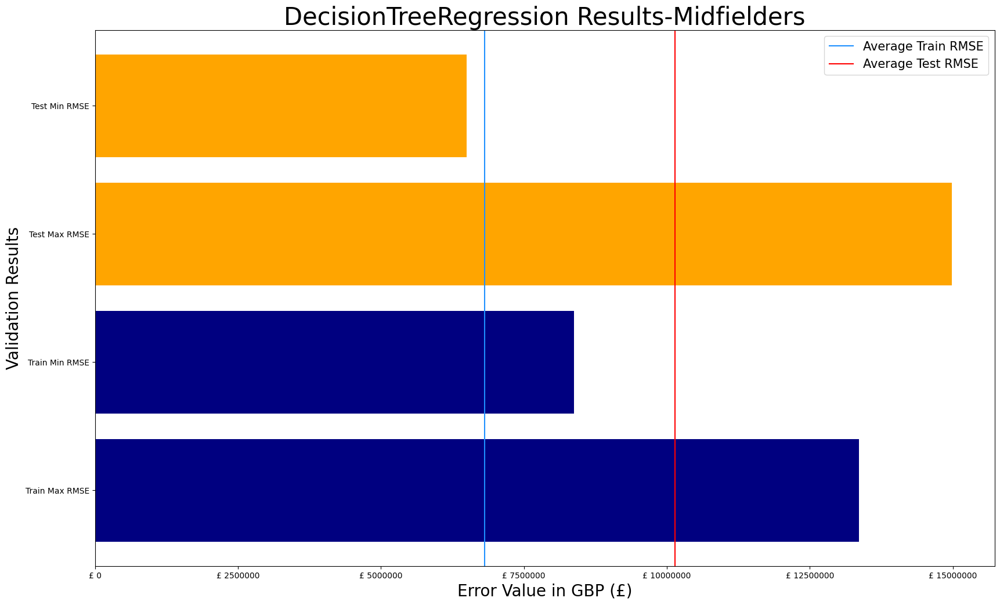

In [232]:
cross_val_train = cross_val_score(DtReg_Grid, X_train, y_train, scoring="neg_root_mean_squared_error",cv=5)
cross_val_test = cross_val_score(DtReg_Grid, X_test, y_test, scoring="neg_root_mean_squared_error",cv=5)
#Train Results
cross_val_train_mean = round(-(cross_val_train.mean()),2)
cross_val_train_max = round(-(cross_val_train.min()),2)
cross_val_train_min = round(-(cross_val_train.max()),2)

#Test Results
cross_val_test_mean = round(-(cross_val_test.mean()),2)
cross_val_test_max = round(-(cross_val_test.min()),2)
cross_val_test_min = round(-(cross_val_test.max()),2)

#Creating a Dataframe to display Validation Results
results_mid = pd.DataFrame(columns=['Train/Test','Avg RMSE','Max RMSE','Min RMSE'])
results_mid.loc[0] = ['Train',cross_val_train_mean,cross_val_train_max,cross_val_train_min]
results_mid.loc[1] = ['Test', cross_val_test_mean, cross_val_test_max, cross_val_test_min]
fig, ax = plt.subplots(figsize=(20,12))

x_ticks = list(range(0,max([results_att.iloc[0][2],(round(results_att.iloc[1][2])+1000000)]),2500000))
y_ticks = [1,2,3,4]
y_labels = ['Train Max RMSE','Train Min RMSE','Test Max RMSE','Test Min RMSE']

train_max_pos = 1
train_max = results_att.iloc[0][2]
ax.barh(train_max_pos,train_max,color='navy')

train_min_pos = 2
train_min = results_att.iloc[0][3]
ax.barh(train_min_pos,train_min,color='navy')

test_max_pos = 3
test_max = results_att.iloc[1][2]
ax.barh(test_max_pos,test_max,color='orange')

test_min_pos = 4
test_min = results_att.iloc[1][3]
ax.barh(test_min_pos,test_min,color='orange')

ax.axvline(x = results_mid.iloc[0][1],label = 'Average Train RMSE',color='dodgerblue')
ax.axvline(x = results_mid.iloc[1][1],label = 'Average Test RMSE',color='red')

ax.set_yticks(y_ticks)
ax.set_yticklabels(y_labels)
ax.set_xticks(x_ticks)
ax.set_xticklabels([f'£ {a}' for a in x_ticks])
ax.set_xlabel('Error Value in GBP (£)',fontsize=20)
ax.set_ylabel('Validation Results',fontsize=20)
ax.set_title('DecisionTreeRegression Results-Midfielders',fontsize=30)
ax.legend(fontsize=15)

In [233]:
results_mid

,Train/Test,Avg RMSE,Max RMSE,Min RMSE
0,Train,6817910.71,7628734.23,5995747.14
1,Test,10140349.22,12651504.59,5788035.58


In [234]:
from sklearn.metrics import r2_score

# Predict on the training and testing sets
y_train_pred = DtReg_Grid.predict(X_train)
y_test_pred = DtReg_Grid.predict(X_test)

# Calculate R-squared
train_r2 = r2_score(y_train, y_train_pred)
test_r2 = r2_score(y_test, y_test_pred)

# Calculate the number of features
num_features = X_train.shape[1]

# Calculate adjusted R-squared
train_adj_r2 = 1 - (1 - train_r2) * ((len(y_train) - 1) / (len(y_train) - num_features - 1))
test_adj_r2 = 1 - (1 - test_r2) * ((len(y_test) - 1) / (len(y_test) - num_features - 1))

# Print the R-squared and adjusted R-squared values
print("Train R-squared:", train_r2)
print("Test R-squared:", test_r2)
print("Train Adjusted R-squared:", train_adj_r2)
print("Test Adjusted R-squared:", test_adj_r2)

Train R-squared: 0.3866451969428264
Test R-squared: 0.1237559893258503
Train Adjusted R-squared: 0.372545086527719
Test Adjusted R-squared: 0.060603267835821595


# Defenders

In [53]:
defender = df[df['Position'] == 'Defender']
defender.head()

,Player,Age,Matches Played,Start,Goals,Assists,Penalties Made,Yellow Cards,Red Cards,Shots,...,Successful Challenge %,Blocks,Interceptions,Tackles + Interceptions,Clearances,Errors,Club,Position,Nation,Value
5,Alejandro Balde,18,33,30,1.0,6.0,0.0,4.0,0.0,19,...,58.5,25.0,12,54.0,17.0,1.0,FC Barcelona,Defender,Spain,46000000.0
10,Josko Gvardiol,20,30,24,1.0,0.0,0.0,2.0,0.0,14,...,40.9,34.0,34,57.0,76.0,1.0,RB Leipzig,Defender,Croatia,40000000.0
14,William Saliba,21,27,27,2.0,1.0,0.0,4.0,0.0,6,...,83.3,13.0,19,53.0,85.0,4.0,Arsenal FC,Defender,France,35000000.0
18,Giorgio Scalvini,18,32,29,2.0,2.0,0.0,7.0,0.0,17,...,52.7,36.0,56,110.0,57.0,2.0,Atalanta BC,Defender,Italy,30000000.0
28,Nuno Mendes,20,23,18,1.0,6.0,0.0,2.0,0.0,10,...,73.2,19.0,17,62.0,18.0,0.0,Paris Saint-Germain,Defender,Portugal,25000000.0


In [54]:
defender.columns

Index(['Player', 'Age', 'Matches Played', 'Start', 'Goals', 'Assists',
       'Penalties Made', 'Yellow Cards', 'Red Cards', 'Shots',
       'Shots On Target', 'Shots On Target %', 'Goals Per Shot',
       'Goals Per Shot On Target', 'Average Shot Distance',
       'Shots From Freekicks', 'Passes Completed', 'Passes',
       'Pass Completion %', 'Total Passing Distance',
       'Progressive Passing Distance', 'Shot-Creating Actions',
       'Shot-Creating Actions/90', 'SCA Pass Live', 'SCA Pass Dead',
       'SCA Take-ons', 'SCA Shots', 'SCA Fouls', 'SCA Defense',
       'Goal-Creating Actions', 'Goal-Creating Actions/90', 'Goal Pass Live',
       'Goal Pass Dead', 'Goal Take-ons', 'Goal Shots', 'Goal Fouls',
       'Goal Defense', 'Tackles', 'Tackles Won', 'Challenges',
       'Successful Challenge %', 'Blocks', 'Interceptions',
       'Tackles + Interceptions', 'Clearances', 'Errors', 'Club', 'Position',
       'Nation', 'Value'],
      dtype='object')

In [56]:
X = defender.drop(['Player', 'Matches Played', 'Start', 'Goals',
       'Penalties Made', 'Yellow Cards', 'Red Cards', 'Shots',
       'Shots On Target', 'Shots On Target %', 'Goals Per Shot',
       'Goals Per Shot On Target', 'Average Shot Distance',
       'Shots From Freekicks', 'Passes Completed', 'Passes',
       'Pass Completion %', 'Total Passing Distance', 'Shot-Creating Actions',
       'Shot-Creating Actions/90', 'SCA Pass Live', 'SCA Pass Dead',
       'SCA Take-ons', 'SCA Shots', 'SCA Fouls', 'SCA Defense',
       'Goal-Creating Actions', 'Goal-Creating Actions/90', 'Goal Pass Live',
       'Goal Pass Dead', 'Goal Take-ons', 'Goal Shots', 'Goal Fouls', 'Position',
       'Nation', 'Value', 'Club'
       ],axis=1)
y = defender['Value']

In [238]:
X.dtypes

Age                               int64
Assists                         float64
Progressive Passing Distance    float64
Goal Defense                    float64
Tackles                         float64
Tackles Won                       int64
Challenges                      float64
Successful Challenge %          float64
Blocks                          float64
Interceptions                     int64
Tackles + Interceptions         float64
Clearances                      float64
Errors                          float64
dtype: object

# Model Training

In [239]:
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.25, random_state=0)

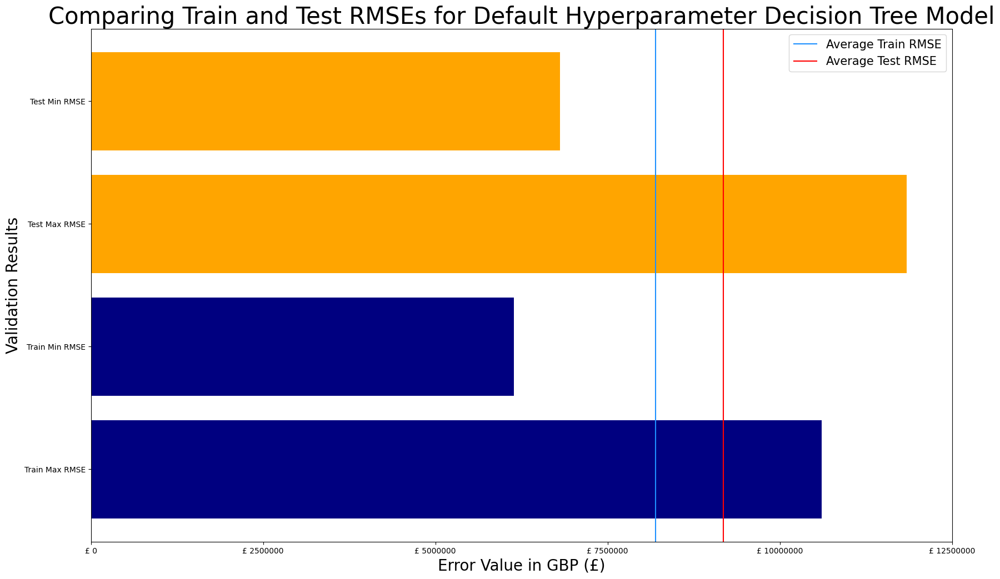

In [240]:
#Robust Scaler
rs= RobustScaler()
X_train = rs.fit_transform(X_train)
X_test = rs.transform(X_test)

DtReg = DecisionTreeRegressor()
DtReg.fit(X_train,y_train)

cross_val_train = cross_val_score(DtReg, X_train, y_train, scoring="neg_root_mean_squared_error",cv=5)
cross_val_test = cross_val_score(DtReg, X_test, y_test, scoring="neg_root_mean_squared_error",cv=5)
#Train Results
cross_val_train_mean = round(-(cross_val_train.mean()),2)
cross_val_train_max = round(-(cross_val_train.min()),2)
cross_val_train_min = round(-(cross_val_train.max()),2)

#Test Results
cross_val_test_mean = round(-(cross_val_test.mean()),2)
cross_val_test_max = round(-(cross_val_test.min()),2)
cross_val_test_min = round(-(cross_val_test.max()),2)

#Creating a Dataframe to display Validation Results
results = pd.DataFrame(columns=['Train/Test','Avg RMSE','Max RMSE','Min RMSE'])
results.loc[0] = ['Train',cross_val_train_mean,cross_val_train_max,cross_val_train_min]
results.loc[1] = ['Test', cross_val_test_mean, cross_val_test_max, cross_val_test_min]

fig, ax = plt.subplots(figsize=(20,12))

x_ticks = list(range(0,max([results.iloc[0][2],(round(results.iloc[1][2])+1000000)]),2500000))
y_ticks = [1,2,3,4]
y_labels = ['Train Max RMSE','Train Min RMSE','Test Max RMSE','Test Min RMSE']

train_max_pos = 1
train_max = results.iloc[0][2]
ax.barh(train_max_pos,train_max,color='navy')

train_min_pos = 2
train_min = results.iloc[0][3]
ax.barh(train_min_pos,train_min,color='navy')

test_max_pos = 3
test_max = results.iloc[1][2]
ax.barh(test_max_pos,test_max,color='orange')

test_min_pos = 4
test_min = results.iloc[1][3]
ax.barh(test_min_pos,test_min,color='orange')

results_def = pd.DataFrame(columns=['Train/Test','Avg RMSE','Max RMSE','Min RMSE'])
results_def.loc[0] = ['Train',cross_val_train_mean,cross_val_train_max,cross_val_train_min]
results_def.loc[1] = ['Test', cross_val_test_mean, cross_val_test_max, cross_val_test_min]

ax.axvline(x = results.iloc[0][1],label = 'Average Train RMSE',color='dodgerblue')
ax.axvline(x = results.iloc[1][1],label = 'Average Test RMSE',color='red')

ax.set_yticks(y_ticks)
ax.set_yticklabels(y_labels)
ax.set_xticks(x_ticks)
ax.set_xticklabels([f'£ {a}' for a in x_ticks])
ax.set_xlabel('Error Value in GBP (£)',fontsize=20)
ax.set_ylabel('Validation Results',fontsize=20)
ax.set_title('Comparing Train and Test RMSEs for Default Hyperparameter Decision Tree Model',fontsize=30)
ax.legend(fontsize=15)

In [241]:
results_def

,Train/Test,Avg RMSE,Max RMSE,Min RMSE
0,Train,8194256.49,10612241.67,6142718.84
1,Test,9182240.73,11844362.02,6808102.34


In [242]:
from sklearn.metrics import r2_score

# Predict on the training and testing sets
y_train_pred = DtReg.predict(X_train)
y_test_pred = DtReg.predict(X_test)

# Calculate R-squared
train_r2 = r2_score(y_train, y_train_pred)
test_r2 = r2_score(y_test, y_test_pred)

# Calculate the number of features
num_features = X_train.shape[1]

# Calculate adjusted R-squared
train_adj_r2 = 1 - (1 - train_r2) * ((len(y_train) - 1) / (len(y_train) - num_features - 1))
test_adj_r2 = 1 - (1 - test_r2) * ((len(y_test) - 1) / (len(y_test) - num_features - 1))

# Print the R-squared and adjusted R-squared values
print("Train R-squared:", train_r2)
print("Test R-squared:", test_r2)
print("Train Adjusted R-squared:", train_adj_r2)
print("Test Adjusted R-squared:", test_adj_r2)

Train R-squared: 0.991722520982235
Test R-squared: -0.2915342601450104
Train Adjusted R-squared: 0.9914568241248747
Test Adjusted R-squared: -0.42478779492187657


In [243]:
vif = pd.DataFrame()
vif["Variable"] = X.columns
vif["VIF"] = [variance_inflation_factor(X.values, i) for i in range(X.shape[1])]
print(vif)

                        Variable        VIF
0                            Age  11.064725
1                        Assists   1.843203
2   Progressive Passing Distance  10.883389
3                   Goal Defense   1.072789
4                        Tackles        inf
5                    Tackles Won  68.258820
6                     Challenges  33.504556
7         Successful Challenge %  11.568720
8                         Blocks  15.610819
9                  Interceptions        inf
10       Tackles + Interceptions        inf
11                    Clearances  10.740537
12                        Errors   1.917522


/Users/tony/Library/Python/3.9/lib/python/site-packages/statsmodels/stats/outliers_influence.py:198: RuntimeWarning: divide by zero encountered in double_scalars
  vif = 1. / (1. - r_squared_i)


In [244]:
X = X.drop(['Tackles + Interceptions', 'Tackles Won', 'Challenges'], axis=1)

In [245]:
vif = pd.DataFrame()
vif["Variable"] = X.columns
vif["VIF"] = [variance_inflation_factor(X.values, i) for i in range(X.shape[1])]
print(vif)

                       Variable        VIF
0                           Age  10.991536
1                       Assists   1.835054
2  Progressive Passing Distance  10.867273
3                  Goal Defense   1.070341
4                       Tackles  10.639578
5        Successful Challenge %  11.395720
6                        Blocks  15.606501
7                 Interceptions  10.128658
8                    Clearances  10.573288
9                        Errors   1.914275


In [246]:
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.25, random_state=0)

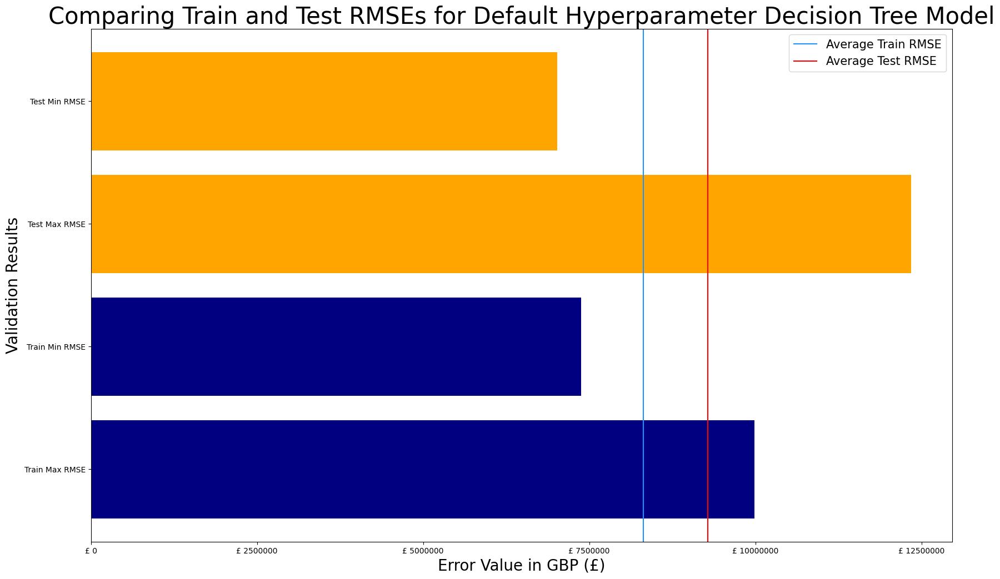

In [247]:
#Robust Scaler
rs= RobustScaler()
X_train = rs.fit_transform(X_train)
X_test = rs.transform(X_test)

pt = PowerTransformer()
X_train = pt.fit_transform(X_train)
X_test = pt.transform(X_test)

DtReg = DecisionTreeRegressor()
DtReg.fit(X_train,y_train)

cross_val_train = cross_val_score(DtReg, X_train, y_train, scoring="neg_root_mean_squared_error",cv=5)
cross_val_test = cross_val_score(DtReg, X_test, y_test, scoring="neg_root_mean_squared_error",cv=5)
#Train Results
cross_val_train_mean = round(-(cross_val_train.mean()),2)
cross_val_train_max = round(-(cross_val_train.min()),2)
cross_val_train_min = round(-(cross_val_train.max()),2)

#Test Results
cross_val_test_mean = round(-(cross_val_test.mean()),2)
cross_val_test_max = round(-(cross_val_test.min()),2)
cross_val_test_min = round(-(cross_val_test.max()),2)

#Creating a Dataframe to display Validation Results
results = pd.DataFrame(columns=['Train/Test','Avg RMSE','Max RMSE','Min RMSE'])
results.loc[0] = ['Train',cross_val_train_mean,cross_val_train_max,cross_val_train_min]
results.loc[1] = ['Test', cross_val_test_mean, cross_val_test_max, cross_val_test_min]

fig, ax = plt.subplots(figsize=(20,12))

x_ticks = list(range(0,max([results.iloc[0][2],(round(results.iloc[1][2])+1000000)]),2500000))
y_ticks = [1,2,3,4]
y_labels = ['Train Max RMSE','Train Min RMSE','Test Max RMSE','Test Min RMSE']

train_max_pos = 1
train_max = results.iloc[0][2]
ax.barh(train_max_pos,train_max,color='navy')

train_min_pos = 2
train_min = results.iloc[0][3]
ax.barh(train_min_pos,train_min,color='navy')

test_max_pos = 3
test_max = results.iloc[1][2]
ax.barh(test_max_pos,test_max,color='orange')

test_min_pos = 4
test_min = results.iloc[1][3]
ax.barh(test_min_pos,test_min,color='orange')

results_def = pd.DataFrame(columns=['Train/Test','Avg RMSE','Max RMSE','Min RMSE'])
results_def.loc[0] = ['Train',cross_val_train_mean,cross_val_train_max,cross_val_train_min]
results_def.loc[1] = ['Test', cross_val_test_mean, cross_val_test_max, cross_val_test_min]

ax.axvline(x = results.iloc[0][1],label = 'Average Train RMSE',color='dodgerblue')
ax.axvline(x = results.iloc[1][1],label = 'Average Test RMSE',color='red')

ax.set_yticks(y_ticks)
ax.set_yticklabels(y_labels)
ax.set_xticks(x_ticks)
ax.set_xticklabels([f'£ {a}' for a in x_ticks])
ax.set_xlabel('Error Value in GBP (£)',fontsize=20)
ax.set_ylabel('Validation Results',fontsize=20)
ax.set_title('Comparing Train and Test RMSEs for Default Hyperparameter Decision Tree Model',fontsize=30)
ax.legend(fontsize=15)

In [248]:
results_def

,Train/Test,Avg RMSE,Max RMSE,Min RMSE
0,Train,8311391.06,9985829.62,7373677.15
1,Test,9285676.75,12340215.60,7015957.58


In [249]:
from sklearn.metrics import r2_score

# Predict on the training and testing sets
y_train_pred = DtReg.predict(X_train)
y_test_pred = DtReg.predict(X_test)

# Calculate R-squared
train_r2 = r2_score(y_train, y_train_pred)
test_r2 = r2_score(y_test, y_test_pred)

# Calculate the number of features
num_features = X_train.shape[1]

# Calculate adjusted R-squared
train_adj_r2 = 1 - (1 - train_r2) * ((len(y_train) - 1) / (len(y_train) - num_features - 1))
test_adj_r2 = 1 - (1 - test_r2) * ((len(y_test) - 1) / (len(y_test) - num_features - 1))

# Print the R-squared and adjusted R-squared values
print("Train R-squared:", train_r2)
print("Test R-squared:", test_r2)
print("Train Adjusted R-squared:", train_adj_r2)
print("Test Adjusted R-squared:", test_adj_r2)

Train R-squared: 0.991722520982235
Test R-squared: -0.388496321283595
Train Adjusted R-squared: 0.9915196415945446
Test Adjusted R-squared: -0.49613169502650933


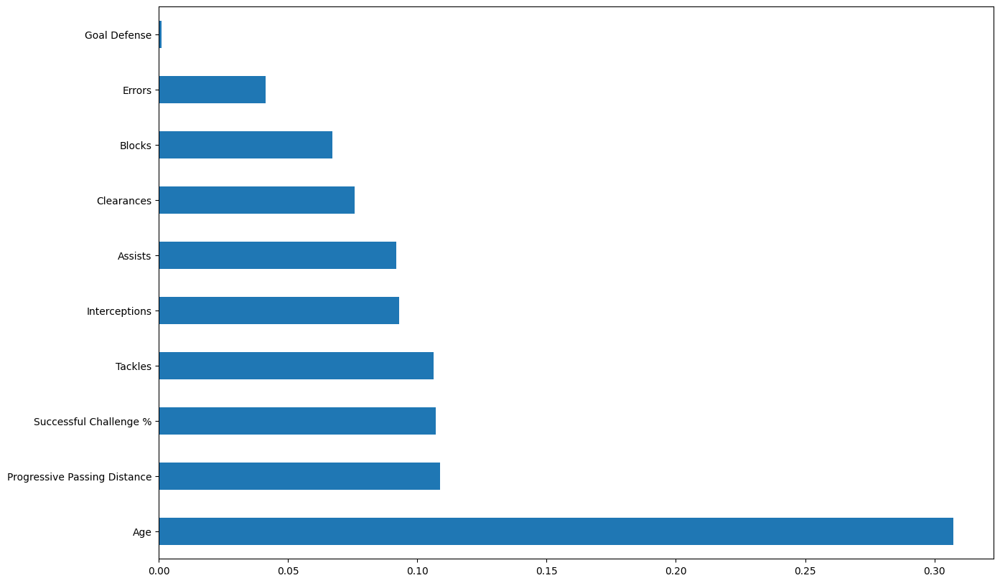

In [250]:
fig,ax = plt.subplots(figsize=(15,10))

feat_importances = pd.Series(DtReg.feature_importances_, index=X.columns)

feat_importances.nlargest(10).plot(kind='barh')

plt.show()

# Tuning

In [251]:
parameters={"splitter":["best","random"],
            "max_depth" : [1,3,5,7,9,11,12],
           "min_samples_leaf":[1,2,3,4,5,6,7,8,9,10],
           "min_weight_fraction_leaf":[0.1,0.2,0.3,0.4,0.5,0.6,0.7,0.8,0.9],
           "max_features":["auto","log2","sqrt",None],
           "max_leaf_nodes":[None,10,20,30,40,50,60,70,80,90] }

tuning_model=GridSearchCV(DtReg,param_grid=parameters,scoring='neg_root_mean_squared_error',cv=5,verbose=5)

from contextlib import contextmanager
import sys
import os

@contextmanager
def suppress_stdout():
    with open(os.devnull, "w") as devnull:
        old_stdout = sys.stdout
        sys.stdout = devnull
        try:
            yield
        finally:
            sys.stdout = old_stdout

# Usage
with suppress_stdout():
    tuning_model.fit(X_train, y_train)


/Users/tony/Library/Python/3.9/lib/python/site-packages/sklearn/tree/_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
/Users/tony/Library/Python/3.9/lib/python/site-packages/sklearn/tree/_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
/Users/tony/Library/Python/3.9/lib/python/site-packages/sklearn/tree/_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
/Users/tony/Library/Python/3.9/lib/python/site-packages/sklearn/tree/_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `m

In [252]:
tuning_model.best_params_

{'max_depth': 11,
 'max_features': None,
 'max_leaf_nodes': 60,
 'min_samples_leaf': 10,
 'min_weight_fraction_leaf': 0.1,
 'splitter': 'random'}

In [253]:
param_values = list((tuning_model.best_params_).values())
param_values

[11, None, 60, 10, 0.1, 'random']

In [254]:
DtReg_Grid = DecisionTreeRegressor(max_depth=param_values[0],
                                 max_features=param_values[1],
                                 max_leaf_nodes=param_values[2],
                                 min_samples_leaf=param_values[3],
                                 min_weight_fraction_leaf=param_values[4],
                                 splitter=param_values[5])

DtReg_Grid.fit(X_train,y_train)

DecisionTreeRegressor(max_depth=11, max_leaf_nodes=60, min_samples_leaf=10,
                      min_weight_fraction_leaf=0.1, splitter='random')

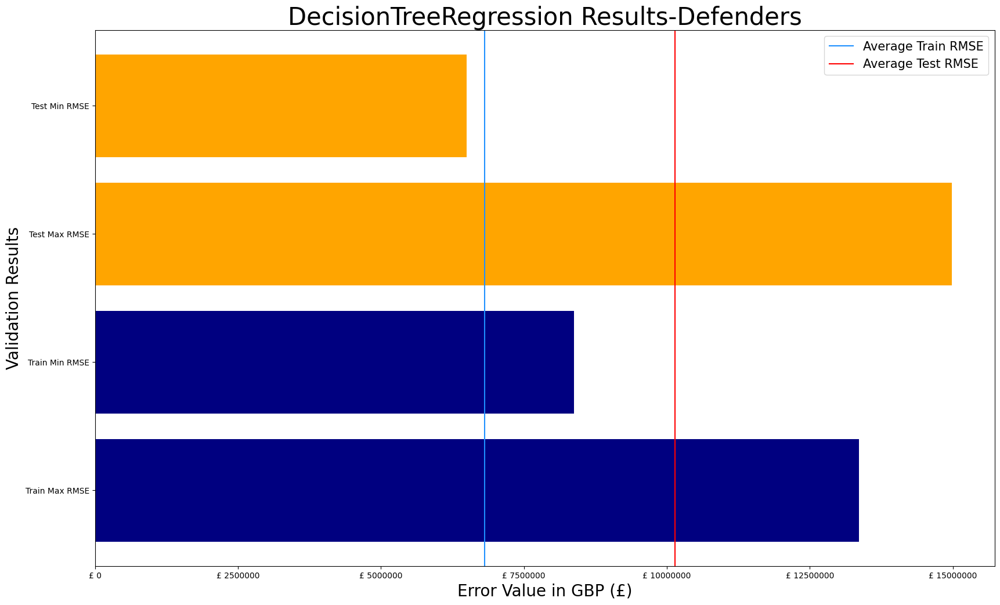

In [255]:
cross_val_train = cross_val_score(DtReg_Grid, X_train, y_train, scoring="neg_root_mean_squared_error",cv=5)
cross_val_test = cross_val_score(DtReg_Grid, X_test, y_test, scoring="neg_root_mean_squared_error",cv=5)
#Train Results
cross_val_train_mean = round(-(cross_val_train.mean()),2)
cross_val_train_max = round(-(cross_val_train.min()),2)
cross_val_train_min = round(-(cross_val_train.max()),2)

#Test Results
cross_val_test_mean = round(-(cross_val_test.mean()),2)
cross_val_test_max = round(-(cross_val_test.min()),2)
cross_val_test_min = round(-(cross_val_test.max()),2)

#Creating a Dataframe to display Validation Results
results_def = pd.DataFrame(columns=['Train/Test','Avg RMSE','Max RMSE','Min RMSE'])
results_def.loc[0] = ['Train',cross_val_train_mean,cross_val_train_max,cross_val_train_min]
results_def.loc[1] = ['Test', cross_val_test_mean, cross_val_test_max, cross_val_test_min]
fig, ax = plt.subplots(figsize=(20,12))

x_ticks = list(range(0,max([results_att.iloc[0][2],(round(results_att.iloc[1][2])+1000000)]),2500000))
y_ticks = [1,2,3,4]
y_labels = ['Train Max RMSE','Train Min RMSE','Test Max RMSE','Test Min RMSE']

train_max_pos = 1
train_max = results_att.iloc[0][2]
ax.barh(train_max_pos,train_max,color='navy')

train_min_pos = 2
train_min = results_att.iloc[0][3]
ax.barh(train_min_pos,train_min,color='navy')

test_max_pos = 3
test_max = results_att.iloc[1][2]
ax.barh(test_max_pos,test_max,color='orange')

test_min_pos = 4
test_min = results_att.iloc[1][3]
ax.barh(test_min_pos,test_min,color='orange')

ax.axvline(x = results_mid.iloc[0][1],label = 'Average Train RMSE',color='dodgerblue')
ax.axvline(x = results_mid.iloc[1][1],label = 'Average Test RMSE',color='red')

ax.set_yticks(y_ticks)
ax.set_yticklabels(y_labels)
ax.set_xticks(x_ticks)
ax.set_xticklabels([f'£ {a}' for a in x_ticks])
ax.set_xlabel('Error Value in GBP (£)',fontsize=20)
ax.set_ylabel('Validation Results',fontsize=20)
ax.set_title('DecisionTreeRegression Results-Defenders',fontsize=30)
ax.legend(fontsize=15)

In [256]:
results_def

,Train/Test,Avg RMSE,Max RMSE,Min RMSE
0,Train,6055156.98,7830623.56,4324328.51
1,Test,6512191.82,9332320.14,4910942.96


In [257]:
from sklearn.metrics import r2_score

# Predict on the training and testing sets
y_train_pred = DtReg_Grid.predict(X_train)
y_test_pred = DtReg_Grid.predict(X_test)

# Calculate R-squared
train_r2 = r2_score(y_train, y_train_pred)
test_r2 = r2_score(y_test, y_test_pred)

# Calculate the number of features
num_features = X_train.shape[1]

# Calculate adjusted R-squared
train_adj_r2 = 1 - (1 - train_r2) * ((len(y_train) - 1) / (len(y_train) - num_features - 1))
test_adj_r2 = 1 - (1 - test_r2) * ((len(y_test) - 1) / (len(y_test) - num_features - 1))

# Print the R-squared and adjusted R-squared values
print("Train R-squared:", train_r2)
print("Test R-squared:", test_r2)
print("Train Adjusted R-squared:", train_adj_r2)
print("Test Adjusted R-squared:", test_adj_r2)

Train R-squared: 0.10372258712247895
Test R-squared: 0.08609797614455106
Train Adjusted R-squared: 0.08175500347352016
Test Adjusted R-squared: 0.015252858016221782


# Graphing All RMSE Together

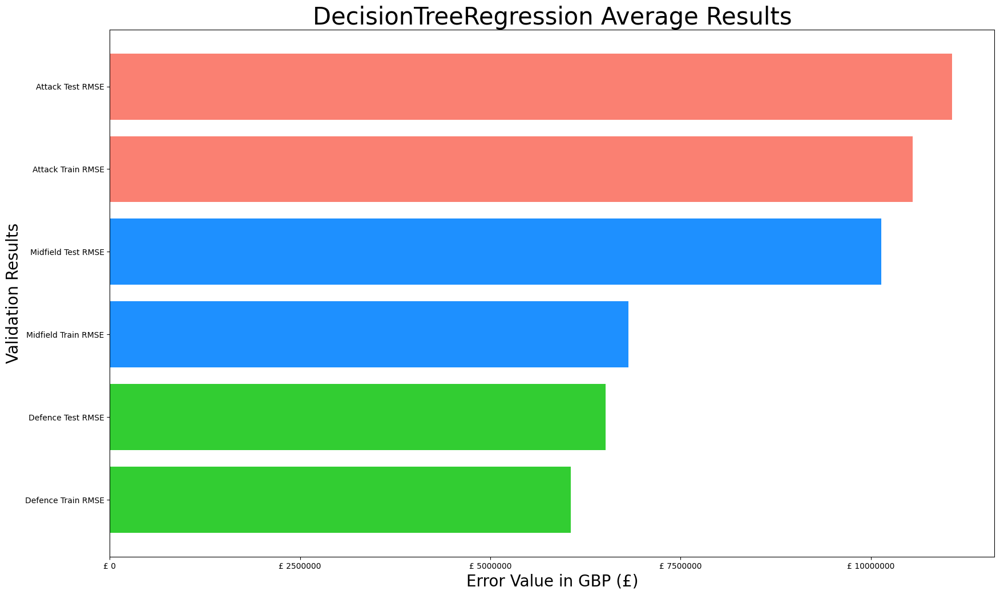

In [258]:
fig, ax = plt.subplots(figsize=(20,12))

x_ticks = list(range(0,int(max([max(results_att['Avg RMSE']),max(results_mid['Avg RMSE']),max(results_def['Avg RMSE'])])+1000000),2500000))
y_ticks = [1,2,3,4,5,6]
y_ticks = [1,2,3,4,5,6]
y_labels = ['Defence Train RMSE','Defence Test RMSE',
            'Midfield Train RMSE','Midfield Test RMSE',
            'Attack Train RMSE','Attack Test RMSE',]

#Attack Results
att_train_pos = 5
att_train = results_att.iloc[0][1]
ax.barh(att_train_pos,att_train,color='salmon')

att_test_pos = 6
att_test = results_att.iloc[1][1]
ax.barh(att_test_pos,att_test,color='salmon')

#Midfield Results
mid_train_pos = 3
mid_train = results_mid.iloc[0][1]
ax.barh(mid_train_pos,mid_train,color='dodgerblue')

mid_test_pos = 4
mid_test = results_mid.iloc[1][1]
ax.barh(mid_test_pos,mid_test,color='dodgerblue')

#Defence Results
def_train_pos = 1
def_train = results_def.iloc[0][1]
ax.barh(def_train_pos,def_train,color='limegreen')

def_test_pos = 2
def_test = results_def.iloc[1][1]
ax.barh(def_test_pos,def_test,color='limegreen')

#Labels
ax.set_yticks(y_ticks)
ax.set_yticklabels(y_labels)
ax.set_xticks(x_ticks)
ax.set_xticklabels([f'£ {a}' for a in x_ticks])
ax.set_xlabel('Error Value in GBP (£)',fontsize=20)
ax.set_ylabel('Validation Results',fontsize=20)
ax.set_title('DecisionTreeRegression Average Results',fontsize=30);